# **Lab #7. Data Preprocessing**
*This material is prepared by Youngji Koh, Hansoo Lee, Yugyeong Jung, Uichin Lee*

## Learning objectives

In Lab #7, we will learn about **data preprocessing techniques**, namely handling noisy data (e.g., removing outliers) and missing values (e.g., deleting or imputing). Data pre-processing makes our data easier to work with and ensures you to get high-quality data! Let's first take a look at how data viz helps data pre-processing.

# **Data Viz for Dataset Understanding**

Data preprocessing is the first step of data viz. But data preprocessing basically assumes that you know much about how the data looks like. Data viz can complement the data preprocessing and help you to better understand the datasets. 

Let's take a look at several examples to see how the data look like. This will help you to check whether there are some problems:  

* **Incomplete data**: Containing missing values or only aggregate data
* **Noisy data**: Containg errors or outliers
* **Inconsistent data**: Containing differences in codes or names etc.

Once you identify that there are such issues, then you can easly deal with them using simple techniques. 

## Example 1. Skin Temperature Data

We'll create a scatter plot that displays the skin temperature of P0710 in the K-EmoPhone dataset. You can move the range slider to zoom in on specific portions of the dataset and view more detailed information about those data points.

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import pandas as pd

df = pd.read_csv('/content/drive/My Drive/CS481_Data Visualization/SkinTemperature-P0710.csv')
df.head()

,timestamp,Temperature
0,1557625541770,31.440001
1,1557625557163,31.620001
2,1557625587239,31.860001
3,1557625617233,32.049999
4,1557625647623,32.250000


In [3]:
import plotly.graph_objects as go

# We will convert timestamp to datetime (ms: milliseconds)
df['datetime'] = pd.to_datetime(df['timestamp'], unit='ms')

fig=go.Figure()
fig.add_trace(go.Scatter(x=df.datetime, y=df.Temperature, mode='markers'))

# Add range slider
# fig.update_layout(
#     xaxis=dict(
#         rangeslider=dict(
#             visible=True),
#         type="datetime"),
#     title='Skin Temperature Data of P0710',
#     width=900
#     )
# fig.update_layout(
#     xaxis={
#         'rangeslider': {'visible': True},
#         'type': "datetime"},
#     title='Skin Temperature Data of P0710',
#     width=900
#     )
# fig.show()

Can you see that **some part of skin-temperature have zero values**? We already know that our skin temperature cannot be naught, so we can easily remove this noisy data items or substitue them into other values (e.g., neighboring values). However, it is often difficult to determine whether it is noisy data or not (how do you ensure that there's an error?) We will learn about how to handle these data in the lecture today! 



## Example 2. ESM Data

Then let's look at another example; this is a survey data in K-EmoPhone dataset. This is the data from 18 users collected over 3 days. Given that the survey arrives approximately once an 45 minutes to user's smartphone (except for sleeping time), it is interesting that there are time zones where users did not respond for a long time!

In [4]:
import pandas as pd
import plotly.express as px
esm_df=pd.read_csv('/content/drive/My Drive/CS481_Data Visualization/esm_data.csv')
#This is to make the 'UID' column as categorical
esm_df['UID']=esm_df['UID'].astype(str)

#List of users that will be visualized
users=['3001', '3002', '3003', '3005', '3007', '3008', '3009', '3010', 
       '3012', '3014', '3015', '3016', '3017', '3018', '3019', '3021', 
       '3022', '3023']

#Filter esm data with specific time range and user list
esm_df=esm_df.loc[(esm_df['responseTime_KDT']<'2019-05-06T00:00:00.000+09:00')
                 &(esm_df['responseTime_KDT']>'2019-05-03T00:00:00.000+09:00')
                 &(esm_df['UID'].isin(users))]

#Draw a dot plot in which x-axis is response time and y-axis is each user
fig = px.scatter(esm_df, y="UID", x="responseTime_KDT", color="UID")
fig.update_yaxes(type='category')
fig.update_layout(title='ESM responses along time',
                  width=900, height=500, showlegend=False)
fig.show()

## Example 3. App Usage Data

This example is important when you deal with app usage event data. This is the app usage data of five users (P1520, P1521, P1523, P1525, P1526). Let's draw bar plots to check what kinds of values are collected in two fields: isSystemApp and isUpdatedSystemApp. 

In [5]:
import pandas as pd
AppUsageEvent=pd.read_csv('/content/drive/My Drive/CS481_Data Visualization/AppUsageEvent.csv')
AppUsageEvent.head()

<ipython-input-5-1be70ec2c103>:2: DtypeWarning:

Columns (4,6) have mixed types. Specify dtype option on import or set low_memory=False.



,Unnamed: 0,timestamp,name,packageName,isSystemApp,type,isUpdatedSystemApp,subject
0,0,1557964800473,안드로이드 시스템,android,True,SCREEN_INTERACTIVE,False,1520
1,1,1557964800752,시계,com.sec.android.app.clockpackage,True,MOVE_TO_FOREGROUND,True,1520
2,2,1557964816116,시계,com.sec.android.app.clockpackage,True,MOVE_TO_BACKGROUND,True,1520
3,3,1557964816207,카카오톡,com.kakao.talk,False,MOVE_TO_FOREGROUND,False,1520
4,4,1557964816214,시계,com.sec.android.app.clockpackage,True,NONE,True,1520


In [6]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import pandas as pd
import numpy as np

AppUsageEvent_groupby1=AppUsageEvent.groupby(['isSystemApp']).count().reset_index()
AppUsageEvent_groupby1.columns.values[1]='Count'
AppUsageEvent_groupby2=AppUsageEvent.groupby(['isUpdatedSystemApp']).count().reset_index()
AppUsageEvent_groupby2.columns.values[1]='Count'

fig = make_subplots(rows=1, cols=2,
                    subplot_titles=("isSystemApp", "isUpdatedSystemApp"))

fig.add_trace(
    go.Bar(x=AppUsageEvent_groupby1.isSystemApp, y=AppUsageEvent_groupby1.Count),
    row=1, col=1
)

fig.add_trace(
    go.Bar(x=AppUsageEvent_groupby2.isUpdatedSystemApp, y=AppUsageEvent_groupby2.Count),
    row=1, col=2
)

fig.update_layout(height=500, width=1000, title_text="App Usage Event Data of Five Users")
fig.show()

Did you find anything wrong? Most of the data are collected as ***false and true***, but some are collected as ***False and True***! (And some data values are even its column name) It's because some true/false are boolean but some are string type. By visualizing the raw data, we can easily know that we need to unify these data into the same format. 

## Example 4. Titanic Data

One easy way of identifying whether there are null values is to draw a heatmap. You can use "isnull()" function to achieve this goal. Take a look at the examples here: https://pandas.pydata.org/docs/reference/api/pandas.isnull.html 

Having said that, let's try to locate missing values of Titanic dataset, which contains information about the passengers of Titanic. You can learn more about this in this article: https://en.wikipedia.org/wiki/Passengers_of_the_Titanic

In [7]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
titanic = pd.read_csv('/content/drive/My Drive/CS481_Data Visualization/titanic.csv')
titanic.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.0,1,0,113803,53.1000,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S


In [8]:
titanic_isnull=titanic.isnull()
# We will map 'True' dataset to 1, and 'False' dataset to 0
titanic_isnull=titanic_isnull*1

# Define x, y, z value to make heatmap
# A horizontal axis(x axis) is column type
x=['PassengerId',	'Survived',	'Pclass',	'Name',	'Sex',	'Age',	
   'SibSp',	'Parch', 'Ticket',	'Fare',	'Cabin',	'Embarked']
# A vertical axis(y-axis) is the number of passengers
y=np.arange(0,891)
# Colors(z) represents whether the data is null(1) or not(0).
z=titanic_isnull.to_numpy()

# You can also use plotly.express imshow() function to make a heatmap. 
# Refer to this link: https://plotly.com/python/heatmaps/
fig = go.Figure(data=go.Heatmap(x=x, y=y, z=z))
fig.update_layout(title='Missing Values in Titanic Dataset')
fig.show()

We can see that **Age** and **Cabin** columns are filled with *missing values*.

This example shows that real-world datasets could have a lot of missing values. If you simply visualize the datasets without considering missing values, it may considerably degrade the quality of your data analysis and visualization. Therefore, before we use any kind of data, it is of utmost importance to ensure that your data *makes sense* and contains the *correct* information.

# **Handling Noisy Data**

Our dataset may contain inaccurate values, which is called **noisy data (outliers)**, that are significantly different from the rest of the data in a dataset. Any ideas on why that happens? There are two sources of outliers: 


**Measurement errors (faulty measurement from sensors)**. For example, your heart rate is 400 bpm. You may want to check whether your sensor (or scale) is good (e.g., whether it's valid or reliable, or whether there is any systematic bias).  
 
**Variability of the target values** would be another major source of outliers due to subject variations or random errors. For example, you can try to push your limits with a heart rate of 190 bpm (say during a hard running instance) 

Let's learn how to handle noisy data. An easy way of checking that would be plotting a distribution (e.g., histograms); another easy way is to draw a box plot that presents the key descriptive statistics (e.g., mean, median, and min/max values). 

## Outlier Detection with Boxplots

As we learned in Lab #4, boxplots are based on the **interquartile range (IQR)**, which is the difference between Q3 and Q1: **IQR = Q3 – Q1**

We can use the IQR for detecting **outliers**. 

First, we define a new range to detect the outliers. Then, any values that lie outside of this range are considered outliers. 

The range is as given below:
* Upper Fence = (Q3) + 1.5 IQR
* Lower Fence = (Q1) – 1.5 IQR

The number (here, 1.5) controls the sensitivity of the range. If the number is bigger, less data point(s) will be considered as outlier(s). These outliers are marked as dots in typical boxplots. 

![대체 텍스트](https://drive.google.com/uc?id=1FBTZQ3Lcd9RIoqcIJ9W0v4fdHKfG0Lzv)

## Dataset: K-EmoPhone's MS-Band dataset

We will examine **skin temperature data of user P0710** in K-EmoPhone dataset. 
That's the skin temperatures of a  wearer, denoted in degrees Celsius. 


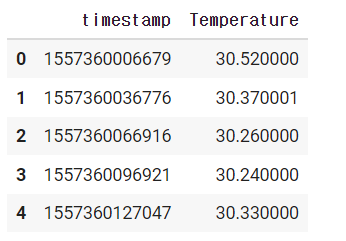

Mount a Google Drive by executing code. It will ask you to enter an authorization code. Please click the URL to give streaming permission, which will give you an authorization code. Copy that code and paste it in the console pane of this section (after pasting, press 'Enter').

In [9]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


1. First, download SkinTemperature-P0710 file, and put the file inside the class folder '/content/drive/My Drive/CS481_Data Visualization/' We are going to read the csv files in the folder.
2. Import the pandas and plotly libraries. Let's read the file, SkinTemperature-P0710.csv. You can easily do this with pd.read_csv, which reads a csv file and returns a dataframe.

In [10]:
import pandas as pd
import plotly.express as px

skin_temperature = pd.read_csv('/content/drive/My Drive/CS481_Data Visualization/SkinTemperature-P0710.csv')
skin_temperature.head()

,timestamp,Temperature
0,1557625541770,31.440001
1,1557625557163,31.620001
2,1557625587239,31.860001
3,1557625617233,32.049999
4,1557625647623,32.250000


3. Create a box plot with the the y axis as the **temperature** column. 

In [11]:
fig = px.box(skin_temperature, y='Temperature') 
fig.update_layout(width=900, height=500)
fig.show()

4. The skin temperature value cannot be zero. We can easily remove outliers by deleting this data!

In [12]:
skin_temperature = skin_temperature[skin_temperature['Temperature'] > 0]

fig = px.box(skin_temperature, y='Temperature') 
fig.update_layout(width=900, height=500)
fig.show()

## Outlier Detection with Standard Deviation

We can also use standard deviation for outlier removal.
You can find the sample standard deviation and use it to detect outliers. A rule of thumb is to use 2 or 3 times the standard deviation (e.g., k * SD). Of course, when using it we basically assume that the sample data follows a normal distribution. This assumption is quite strong in reality. That's why you have to be careful when applying this technique. If you apply this method to a dataset that does not follow normal distributions, some people may argue that you're cheating. 

The following function is adpated from [this article](https://towardsdatascience.com/5-ways-to-detect-outliers-that-every-data-scientist-should-know-python-code-70a54335a623). 

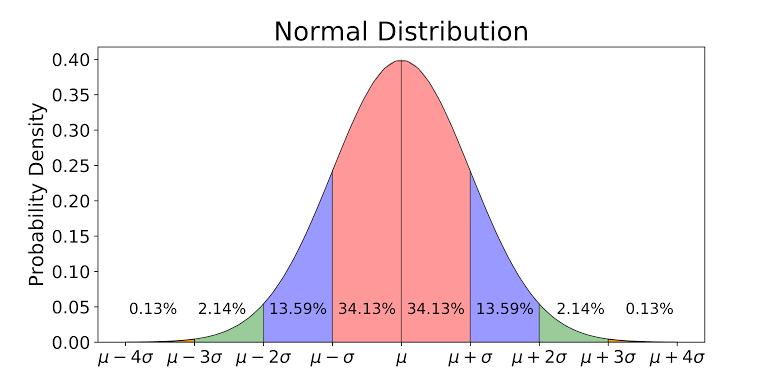

In [13]:
import pandas as pd
import numpy as np

# Function to detection outlier 
def outlier_detection(dataset):
    #define a list to store outliers
    outliers = []
    
    # Set upper and lower limit to 3 * standard deviation
    data_std = np.std(dataset)
    data_mean = np.mean(dataset)
    outlier_cut_off = data_std * 3
    
    lower_limit  = data_mean - outlier_cut_off 
    upper_limit = data_mean + outlier_cut_off

    # Outlier detection
    for data in dataset:
      outlier = False
      if data > upper_limit or data < lower_limit:
        outlier = True
      outliers.append(outlier)
        
    outliers_arr = np.array(outliers)

    return outliers_arr

1. It assumes that a dataset is normally distributed. We will test normality using [SciPy](https://docs.scipy.org/doc/scipy/reference/reference/stats.html).
2. Define a function that checks wheter the dataset is normally distributed.

In [14]:
!pip install scipy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [15]:
# stats module contains a large number of statistical functions
from scipy import stats

def is_normally_distributed(data, alpha = 0.05):
  # stats.normaltest() tests whether a input data differs from a normal distribution
  _, p = stats.normaltest(data) 
  
  # null hypothesis: 'data' comes from a normal distribution
  # If p-value is bigger than alpha (=0.05), dataset is normally distributed 
  return p >= alpha

3. Make an array that has 500 normally distributed random values.

In [16]:
# loc: mean, scale: sd 
np.random.seed(100)
d = np.random.normal(loc=0.0, scale=1.0, size=500)
df = pd.DataFrame(data=d, columns=['x'])

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500 entries, 0 to 499
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x       500 non-null    float64
dtypes: float64(1)
memory usage: 4.0 KB


4. Returns a list showing outliers (True = outlier) using SD based detection.
3. Print how many outliers are there.

In [17]:
x = df.x
print('Mean =%f, SD = %f'%(np.mean(x), np.std(x)))
print('Is normally distrubuted?', is_normally_distributed(x))

# Add 'outlier' column that showing true if df.x for a given row is outlier
df['outlier'] = outlier_detection(df.x) 
print(df['outlier'])

# shape[] represents the dimensionality of the DataFrame (0: row, 1: col)
print('\nThe number of outliers: {}'.format(df[df.outlier == True].shape[0])) 
print(df[df.outlier == True])

Mean =-0.005418, SD = 1.032801
Is normally distrubuted? True
0      False
1      False
2      False
3      False
4      False
       ...  
495    False
496    False
497    False
498    False
499    False
Name: outlier, Length: 500, dtype: bool

The number of outliers: 3
            x  outlier
221  3.465227     True
302  3.173391     True
303  3.334204     True


6. Show the outliers with histogram.

In [18]:
import plotly.express as px
fig = px.histogram(df, x="x")
fig.show()

7. Show different color depending on boolean value (TRUE or FALSE) in outlier column.

In [19]:
import plotly.express as px
fig = px.histogram(df, x="x", color="outlier") 
fig.show()

8. Show the outliers with scatterplot.


In [20]:
import plotly.graph_objects as go

# We will map 'True' dataset to 1, and 'False' dataset to 0
df.outlier = df.outlier*1

fig = go.Figure()
fig.add_trace(go.Scatter(x=df.x, y=df.index, mode='markers', marker_color=df.outlier))
fig.show()

## Mini-Exercise #1

For mini-exercise #1, we will visualize the data to check outliers in the **SkinTemperature-P0710.csv**.

(1) We will make a box plot with different color depending on the date.
*  Convert timestamp to date using [pandas.to_datetime](https://pandas.pydata.org/docs/reference/api/pandas.to_datetime.html)
*   Make a box plot with different color. What do you see here? How can we identify outliers?


In [21]:
import pandas as pd
import plotly.express as px

skin_temperature = pd.read_csv('/content/drive/My Drive/CS481_Data Visualization/SkinTemperature-P0710.csv')
skin_temperature.head()

# Convert timestamp to date using pd.to_datetime()
# You can use following code
skin_temperature['date'] = pd.to_datetime(skin_temperature['timestamp'], unit='ms').dt.strftime('%Y-%m-%d')

In [22]:
# Answer
fig = px.box(skin_temperature, x='date', y='Temperature', color='date') 
fig.show()

(2) We will make a histogram with different color depending on boolean value (TRUE or FALSE) in outlier column.
* Print how many outliers are there
* Make a histogram with different color

In [23]:
# Answer
skin_temperature['outlier'] = outlier_detection(skin_temperature.Temperature) 

fig = px.histogram(skin_temperature, x='Temperature', color="outlier") 
fig.show()

print('The number of outliers: {}'.format(skin_temperature[skin_temperature.outlier == True].shape[0])) 

The number of outliers: 4


Submission link: https://docs.google.com/document/d/1rZZMq2CWCQ_pDVbYzxz37xgXd5Rx3h3PAbt23K9tD38/edit

# **Handling Missing Values**

Obviously, the dataset could contain a lot of **missing values**. It is caused by a lot of outliers that we removed in the previous step, or possibly by sensors not providing information at certain points in time.  To handle missing values, we can delete or replace these missing values.

### Deletion

**Deletion** has two types; listwise deletion and pairwise deletion.

**Listwise deletion** removes all data for a case that has one or more missing values (see below examples). If you want to know more about pros/cons of this approach, please read this [document](https://www.statisticssolutions.com/missing-data-listwise-vs-pairwise/).



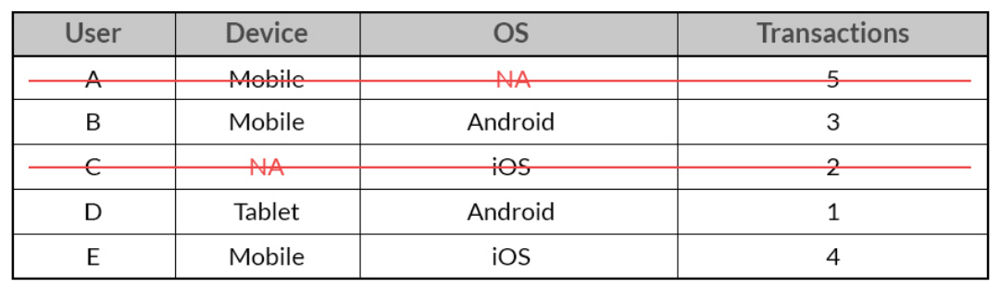

**Pairwise deletion** attempts to minimize the loss that occurs in listwise deletion: missing observations are ignored and analysis is done on variables present. 


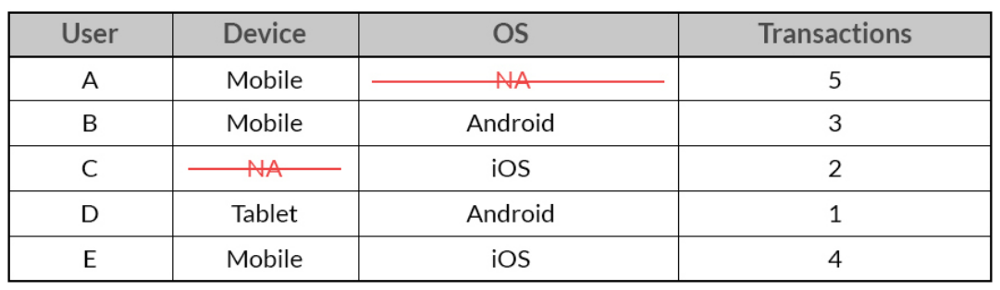

First, we will create sample data.

In [24]:
import numpy as np
import pandas as pd

dict={'First':[100,np.nan,np.nan,95],
      'Second':[30,np.nan,45,56],
      'Third':[52,np.nan,80,98],
      'Fourth':[np.nan,np.nan,np.nan,65]}
      
df=pd.DataFrame(dict)
df.head()

,First,Second,Third,Fourth
0,100.0,30.0,52.0,NaN
1,NaN,NaN,NaN,NaN
2,NaN,45.0,80.0,NaN
3,95.0,56.0,98.0,65.0


Drop rows that contain missing values. You can learn more about how to use dropna here: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.dropna.html 

In [25]:
# axis: 0 (row), 1(column)
df.dropna(axis=0) 
#df.dropna(axis=0, how='any')

,First,Second,Third,Fourth
3,95.0,56.0,98.0,65.0


Drop rows or columns if all values are missing.

In [26]:
df.dropna(how='all')

,First,Second,Third,Fourth
0,100.0,30.0,52.0,NaN
2,NaN,45.0,80.0,NaN
3,95.0,56.0,98.0,65.0


Also, we can set a threshhold.





In [27]:
# Keep only the rows with at least 3 non-NA values
df.dropna(thresh=3)

,First,Second,Third,Fourth
0,100.0,30.0,52.0,NaN
3,95.0,56.0,98.0,65.0


Define columns to look for missing values.

In [28]:
df.dropna(subset=['Second', 'Third'])

,First,Second,Third,Fourth
0,100.0,30.0,52.0,NaN
2,NaN,45.0,80.0,NaN
3,95.0,56.0,98.0,65.0


### Imputation

**Imputation** is the process of replacing missing data with substituted values. When one or more values are missing, discarding rows or columns that have a missing value may introduce bias or affect the representativeness of the results. Imputation preserves a missing value by replacing it with an estimated value based on other available information, which is forward/backward value, or interpolation.


We will use sample data again.

In [29]:
df.head()

,First,Second,Third,Fourth
0,100.0,30.0,52.0,NaN
1,NaN,NaN,NaN,NaN
2,NaN,45.0,80.0,NaN
3,95.0,56.0,98.0,65.0


Replace missing values with a certain value (number or string): df.fillna('certain value')

In [30]:
# Replace with string, 'missing'
df_missing=df.fillna('missing') 
df_missing

,First,Second,Third,Fourth
0,100.0,30.0,52.0,missing
1,missing,missing,missing,missing
2,missing,45.0,80.0,missing
3,95.0,56.0,98.0,65.0


Fill values forward or backward.

In [31]:
df.fillna(method='ffill')
# df.fillna(method='pad')

,First,Second,Third,Fourth
0,100.0,30.0,52.0,NaN
1,100.0,30.0,52.0,NaN
2,100.0,45.0,80.0,NaN
3,95.0,56.0,98.0,65.0


In [32]:
df.fillna(method='bfill')
#df.fillna(method='backfill')

,First,Second,Third,Fourth
0,100.0,30.0,52.0,65.0
1,95.0,45.0,80.0,65.0
2,95.0,45.0,80.0,65.0
3,95.0,56.0,98.0,65.0


Filling missing values with mean value per columns: df.fillna(df.mean())
or we can use median value, df.median().

In [33]:
# mean per columns
df.mean() 

First     97.500000
Second    43.666667
Third     76.666667
Fourth    65.000000
dtype: float64

In [34]:
df.fillna(df.mean()) 

,First,Second,Third,Fourth
0,100.0,30.000000,52.000000,65.0
1,97.5,43.666667,76.666667,65.0
2,97.5,45.000000,80.000000,65.0
3,95.0,56.000000,98.000000,65.0


Interpolate missing values

* Interpolation is a mathematical method that adjusts a function to your data and uses this function to extrapolate the missing data. The most simple type of interpolation is the linear interpolation, that makes a mean between the values before the missing data and the value after.

In [35]:
df.interpolate()
# If you want to fill at most two consecutive NaN at a time: df.interpolate(limit=2)

,First,Second,Third,Fourth
0,100.000000,30.0,52.0,NaN
1,98.333333,37.5,66.0,NaN
2,96.666667,45.0,80.0,NaN
3,95.000000,56.0,98.0,65.0


Here's the summary of dealing with missing values in the data frame


*   dropna() - drop missing observations
*   dropna(how='all') - drop observerations where all cells is NA
*   dropna(axis=1, how='all') - drop column if all the values are missing
*   dropna(thresh = 5) - drop rows that contain less than 5 non-missing values 
*   fillna(0) - replace missing values with zeros
*   isnull() - returns True if the value is missing
*   notnull() - returns True for non-missing values 



## Mini-Exercise #2

We learned about visualizing and handling technique of missing values with simple dataframe. Now let's pratice with Titanic dataset about handling missing values and visualizing data.

## Dataset: Titanic dataset

For mini-exercise, we will use the **Titanic dataset**, which contains information about the passengers of Titanic.

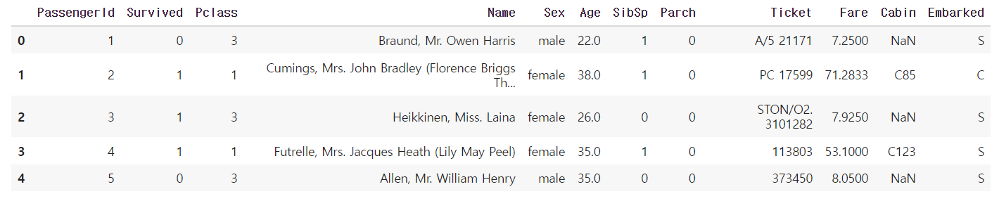

1. First, download titanic.csv file, and put the file inside the class folder '/content/drive/My Drive/CS492_Data Visualization/' We are going to read the csv files in the folder.
2. Import pandas, numpy, and plotly libraries. Then we will read the file, titanic.csv
 





In [36]:
import numpy as np
import pandas as pd
titanic = pd.read_csv('/content/drive/My Drive/CS481_Data Visualization/titanic.csv')
titanic.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.0,1,0,113803,53.1000,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S


3. Check the number of missing values ​​for each column.

In [37]:
titanic.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 891 entries, 0 to 890
Data columns (total 12 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   PassengerId  891 non-null    int64  
 1   Survived     891 non-null    int64  
 2   Pclass       891 non-null    int64  
 3   Name         891 non-null    object 
 4   Sex          891 non-null    object 
 5   Age          714 non-null    float64
 6   SibSp        891 non-null    int64  
 7   Parch        891 non-null    int64  
 8   Ticket       891 non-null    object 
 9   Fare         891 non-null    float64
 10  Cabin        204 non-null    object 
 11  Embarked     889 non-null    object 
dtypes: float64(2), int64(5), object(5)
memory usage: 83.7+ KB


In [38]:
titanic.isnull().sum()

PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age            177
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
dtype: int64

Based on the information above, let's practice the following things!

(1) Removes all data for a case that has one or more missing values 
* Remove the rows with missing value from the titanic dataset.
* Check the number of missing values ​​for each column of the titanic dataset.

In [39]:
# Answer
titanic_without_missing_value = titanic.dropna(axis=0)
titanic_without_missing_value.info()
titanic_without_missing_value.isnull().sum()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 183 entries, 1 to 889
Data columns (total 12 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   PassengerId  183 non-null    int64  
 1   Survived     183 non-null    int64  
 2   Pclass       183 non-null    int64  
 3   Name         183 non-null    object 
 4   Sex          183 non-null    object 
 5   Age          183 non-null    float64
 6   SibSp        183 non-null    int64  
 7   Parch        183 non-null    int64  
 8   Ticket       183 non-null    object 
 9   Fare         183 non-null    float64
 10  Cabin        183 non-null    object 
 11  Embarked     183 non-null    object 
dtypes: float64(2), int64(5), object(5)
memory usage: 18.6+ KB


PassengerId    0
Survived       0
Pclass         0
Name           0
Sex            0
Age            0
SibSp          0
Parch          0
Ticket         0
Fare           0
Cabin          0
Embarked       0
dtype: int64

(2) Fill in the missing values ​​in the titanic dataset using interpolate imputation.

In [40]:
# Answer
titanic = titanic.interpolate()
titanic.info()
titanic.isnull().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 891 entries, 0 to 890
Data columns (total 12 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   PassengerId  891 non-null    int64  
 1   Survived     891 non-null    int64  
 2   Pclass       891 non-null    int64  
 3   Name         891 non-null    object 
 4   Sex          891 non-null    object 
 5   Age          891 non-null    float64
 6   SibSp        891 non-null    int64  
 7   Parch        891 non-null    int64  
 8   Ticket       891 non-null    object 
 9   Fare         891 non-null    float64
 10  Cabin        204 non-null    object 
 11  Embarked     889 non-null    object 
dtypes: float64(2), int64(5), object(5)
memory usage: 83.7+ KB


PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age              0
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
dtype: int64

Submission link: https://docs.google.com/document/d/1KWkw3T1GbiqxpTt0lOd65jp_AemSiiO53SLf9Q-9MTo/edit#

# **Homework #7. Data Pre-processing**

We will preprocess Microsoft Band 2 data. Please download **Accelerometer-P0710.csv file** from KLMS. It contains the acceleration value of each axis (i.e., X, Y, Z).

In homework #7, You should do following things: 
1.   **Outlier Detection**: Detect outliers and convert them to missing values (=NaN) 
2.   **Deletion & Imputation**: Handle missing values using deletion and imputation

In [41]:
accelerometer = pd.read_csv('/content/drive/My Drive/CS481_Data Visualization/Accelerometer-P0710.csv')
accelerometer = accelerometer[['timestamp', 'X', 'Y', 'Z']]
accelerometer.head()

,timestamp,X,Y,Z
0,1557537779682,-1.005127,0.010986,-0.010498
1,1557537779812,-1.004883,0.009033,-0.013428
2,1557537779944,-1.006592,0.011230,-0.011963
3,1557537780058,-1.003418,0.009766,-0.011963
4,1557537780176,-1.006104,0.010010,-0.010254


**(1) Outlier detection**: 

* Create a box plot with each axis (X, Y, Z).
* Please choose the most reasonable outlier detection approach (and its setting) and explain why you think so.
* Detect outliers using the method you choose, then convert outliers to [NaN](https://numpy.org/doc/stable/user/misc.html) value. This data will be used for data imputation in the second question. 
* Please print [DataFrame.info()](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.info.html) on the last line.


In [42]:
# Create a box plot with each axis (X, Y, Z).
fig = px.box(accelerometer, y=['X', 'Y', 'Z'])
fig.show()

By observing above box plots, I could find outliers of each axis. I would get rid of them by using the definition of outlier in boxpolt. I would calculate IQR, and the values smaller than Q1 - 1.5 x IQR and the values greater than Q3 + 1.5 x IQR would be changed to NaN.

In [43]:
# Original dataset information.
accelerometer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 312498 entries, 0 to 312497
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   timestamp  312498 non-null  int64  
 1   X          312498 non-null  float64
 2   Y          312498 non-null  float64
 3   Z          312498 non-null  float64
dtypes: float64(3), int64(1)
memory usage: 9.5 MB


In [44]:
# Choose the most reasonable outlier detection approach.
Q1 = accelerometer[['X', 'Y', 'Z']].quantile(q=0.25)
Q3 = accelerometer[['X', 'Y', 'Z']].quantile(q=0.75)
IQR = Q3 - Q1
accelerometer.loc[(accelerometer['X'] < Q1['X'] - 1.5*IQR['X']) | (accelerometer['X'] > Q3['X'] + 1.5*IQR['X']), 'X'] = np.NaN
accelerometer.loc[(accelerometer['Y'] < Q1['Y'] - 1.5*IQR['Y']) | (accelerometer['Y'] > Q3['Y'] + 1.5*IQR['Y']), 'Y'] = np.NaN
accelerometer.loc[(accelerometer['Z'] < Q1['Z'] - 1.5*IQR['Z']) | (accelerometer['Z'] > Q3['Z'] + 1.5*IQR['Z']), 'Z'] = np.NaN

In [45]:
# Dataset information after ouliers detection.
accelerometer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 312498 entries, 0 to 312497
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   timestamp  312498 non-null  int64  
 1   X          312497 non-null  float64
 2   Y          292266 non-null  float64
 3   Z          242642 non-null  float64
dtypes: float64(3), int64(1)
memory usage: 9.5 MB


**(2) Deletion & Imputation:**

* Visualize the location of  missing values using heatmap - please note that in (1) Outlier Detection, you should have replaced the outliers with NaN. 
* Drop rows or columns if all values are missing. 
* Replace missing data with substitute values using any imputation method you want; and explain why you did that. 
* Please print [DataFrame.info()](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.info.html) on the last line.



In [46]:
# Visualize the location of missing values using heatmap.
accelerometer_isnull=accelerometer.isnull()
accelerometer_isnull=accelerometer_isnull*1
accelerometer_isnull=accelerometer_isnull.drop(labels='timestamp', axis=1)
x = ['X', 'Y', 'Z']
y = accelerometer['timestamp']
z = accelerometer_isnull.to_numpy()

fig = go.Figure(data=go.Heatmap(x=x, y=y, z=z))
fig.show()

In [47]:
accelerometer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 312498 entries, 0 to 312497
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   timestamp  312498 non-null  int64  
 1   X          312497 non-null  float64
 2   Y          292266 non-null  float64
 3   Z          242642 non-null  float64
dtypes: float64(3), int64(1)
memory usage: 9.5 MB


In [48]:
# Drop rows or columns if all values are missing.
accelerometer.drop('timestamp', axis=1, inplace=True)
accelerometer.dropna(how='all', axis=0, inplace=True)
accelerometer.dropna(how='all', axis=1, inplace=True)
accelerometer.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 312497 entries, 0 to 312497
Data columns (total 3 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   X       312497 non-null  float64
 1   Y       292266 non-null  float64
 2   Z       242642 non-null  float64
dtypes: float64(3)
memory usage: 9.5 MB


In [49]:
# Replace missing data with substitute values using any imputation method
accelerometer = accelerometer.interpolate()

The movement of human must be continuous, not discrete. The acceleration get impact by previous acceleration and make impact on next acceleration by time. Thus, interpolate method is appropriate for accelerometer data.

In [50]:
accelerometer.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 312497 entries, 0 to 312497
Data columns (total 3 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   X       312497 non-null  float64
 1   Y       312497 non-null  float64
 2   Z       312497 non-null  float64
dtypes: float64(3)
memory usage: 9.5 MB


## Grading Criteria

**Question #1 (50 points)**

* Create a box plot with each axis (X, Y, Z). (20 points)
* Choose the most reasonable approach (and its setting) and explain why you think so. (10 points)
* Detect outliers using the method you choose, then convert outliers to NaN value. (20 points)


**Question #2 (50 points)**

* Visualize the location of  missing values using heatmap. (20 points)
* Drop rows or columns if all values are missing. (10 points)
* Replace missing data with substitute values using any imputation method and explain why you did that. (20 points)



# **References**


* Outlier detection using IQR: https://www.statisticshowto.com/find-outliers/ 
* Chauvenet's criterion: https://www.statisticshowto.com/chauvenets-criterion/
* Imputation missing data: [Fexible Imputation of Missing Data, 2nd Edition by Stef van Buuren](https://stefvanbuuren.name/fimd/)
* Titanic dataset sources:
https://www.kaggle.com/c/titanic/data?select=train.csv